In [1]:
import torch

# Check PyTorch version
print(torch.__version__)

2.2.2+cpu


In [2]:
#Code Written by Diana Lewis
## Code edited and debugged by Matthew Miller
## Additional help from ChatGPT and Label Studio documentation
import numpy as np
import os
import cv2
import csv
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf 
from tensorflow.keras import layers, models 
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import torchvision
from torchvision import transforms as T

RuntimeError: operator torchvision::nms does not exist

In [ ]:
#Input Images from File to train the model 
# Specify the folder containing the images and CSV file
folder_path = 'Glaucoma_Balanced_Dataset/Preprocessed_images_input_to_bound'

# Load preprocessed images
images = []    #images should not be a list, it needs to be a 4D numpy array
for i in range(30):  # Assuming 30 images starting from 000000
    image_filename = f'enhanced_TRAIN{i:06d}.jpg'  # Zero-padded 6-digit number
    image_path = os.path.join(folder_path, image_filename)
    image = cv2.imread(image_path)
    images.append(image)
    
# Load bounding box labels from CSV file
bounding_box_labels = []
image_filenames = []  # List to store image filenames
csv_file = os.path.join(folder_path, 'Glaucoma30_bounding_boxes_06Apr2024.csv')
with open(csv_file, 'r') as csvfile:
    csvreader = csv.reader(csvfile)
    next(csvreader)  # Skip header row
    for row in csvreader:
        # Extract image filename from column 4 (assuming 0-based indexing)
        image_filename = row[3].strip()  # Remove leading/trailing whitespaces
        image_filenames.append(image_filename)  # Add filename to the list
        # Extract bounding box parameters from the "rect" column
        bbox_params = eval(row[5])  # Assuming "rect" is the 6th column
        # Extract individual bounding box parameters from the list of dictionaries
        bbox_dict = bbox_params[0]  # Assuming there's only one dictionary in the list
        x = int(bbox_dict['x'])
        y = int(bbox_dict['y'])
        width = int(bbox_dict['width'])
        height = int(bbox_dict['height'])

        ##### Adjust bounding box parameters (trial and error)
        #x_adjusted = x * 21  # Adjust x-coordinate by adding 10 pixels
        #y_adjusted = y * 10 # Adjust y-coordinate by adding 10 pixels
        #width_adjusted = width * 21  # Adjust width by scaling by a factor of 1.1
        #height_adjusted = height * 10  # Adjust height by scaling by a factor of 1.1
        ##### Add bounding box parameters to the list
        #bounding_box_labels.append([x, y, width, height])
        
        
        #Matt found the real way to deal the image image size mismatch
        #label studio just gives the percentages of the overall image size for the bounding box
        #Here's the non trial and error method:
        
        #These are needed to show what image size the boxes have to go back to
        original_width = 2048
        original_height = 1024
        
        x_adjusted = int(x / 100.0 * original_width)
        y_adjusted = int(y / 100.0 * original_height)
        width_adjusted = int(width / 100.0 * original_width)
        height_adjusted = int(height / 100.0 * original_height)
        
        bounding_box_labels.append([x_adjusted, y_adjusted, width_adjusted, height_adjusted])

        # Process bounding box parameters as needed
        # Example: Print adjusted bounding box parameters
        print(f"Image: {image_filename}, Adjusted Bounding Box: x={x_adjusted}, y={y_adjusted}, "
                  f"width={width_adjusted}, height={height_adjusted}")


# Save bounding box labels into a CSV file
csv_output_file = os.path.join(folder_path, 'bounding_box_labels_adjusted.csv')
with open(csv_output_file, 'w', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(['Image', 'X', 'Y', 'Width', 'Height'])  # Write header row
    for filename, bbox in zip(image_filenames, bounding_box_labels):
        csvwriter.writerow([filename] + bbox)

# Convert bounding box labels to numpy array
labels = np.array(bounding_box_labels)

# Split dataset into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(images, labels, test_size=0.2, random_state=42)

In [3]:
# Print lengths of images and bounding_box_labels lists
print("Number of images:", len(images))
print("Number of bounding box labels:", len(bounding_box_labels))

# Print contents of bounding_box_labels list
#for idx, label in enumerate(bounding_box_labels):
    #print(f"Label {idx + 1}:", label)

print("Number of images in X_train:", len(X_train))
print("Number of labels in y_train:", len(y_train))

# Print a few samples from X_train and y_train
for i in range(min(30, len(X_train))):
    print("Image shape:", X_train[i].shape)
    print("Label:", y_train[i])

#DEBUGGING
#print("Image filenames:", image_filenames)
#print("Image filename from CSV:", image_filename)

# Convert lists to numpy arrays
X_train_np = np.array(X_train)
y_train_np = np.array(y_train)
X_val_np = np.array(X_val)
y_val_np = np.array(y_val)

print("Shape of X_train:", X_train_np.shape)
print("Shape of y_train:", y_train_np.shape)

# Check shapes
#print("Shape of X_train:", X_train.shape)
#print("Shape of y_train:", y_train.shape)
print("Shape of X_val:", X_val_np.shape)
print("Shape of y_val:", y_val_np.shape)

# Inspect a few samples
print("Sample image from X_train:", X_train[0].shape)
print("Sample bounding box from y_train:", y_train[0])
print("Sample image from X_val:", X_val[0].shape)
print("Sample bounding box from y_val:", y_val[0])

NameError: name 'images' is not defined

In [89]:
# Load bounding box labels from CSV file
csv_file = os.path.join(folder_path, 'Glaucoma30_bounding_boxes_06Apr2024.csv')
with open(csv_file, 'r') as csvfile:
    csvreader = csv.reader(csvfile)
    next(csvreader)  # Skip header row
    for row in csvreader:
        # Extract image filename from the 4th column
        image_filename = row[3]  # Assuming image filename is in the 4th column
        print("Image filename from CSV:", image_filename)
        
        # Find the index of the image filename in the list of image filenames
        image_index = [i for i, filename in enumerate(image_filenames) if filename == image_filename]
        print("Index of image filename:", image_index)
        
        # Print the bounding box label corresponding to the image
        bounding_box_label = bounding_box_labels[image_index[0]]
        print("Bounding box label:", bounding_box_label)

Image filename from CSV: enhanced_TRAIN000000.jpg
Index of image filename: [0]
Bounding box label: [245, 235, 327, 368]
Image filename from CSV: enhanced_TRAIN000001.jpg
Index of image filename: [1]
Bounding box label: [1433, 194, 327, 337]
Image filename from CSV: enhanced_TRAIN000002.jpg
Index of image filename: [2]
Bounding box label: [512, 440, 225, 235]
Image filename from CSV: enhanced_TRAIN000003.jpg
Index of image filename: [3]
Bounding box label: [430, 235, 307, 358]
Image filename from CSV: enhanced_TRAIN000004.jpg
Index of image filename: [4]
Bounding box label: [1187, 337, 245, 256]
Image filename from CSV: enhanced_TRAIN000005.jpg
Index of image filename: [5]
Bounding box label: [1249, 378, 266, 286]
Image filename from CSV: enhanced_TRAIN000006.jpg
Index of image filename: [6]
Bounding box label: [1228, 153, 450, 450]
Image filename from CSV: enhanced_TRAIN000007.jpg
Index of image filename: [7]
Bounding box label: [1331, 184, 348, 368]
Image filename from CSV: enhanced_T

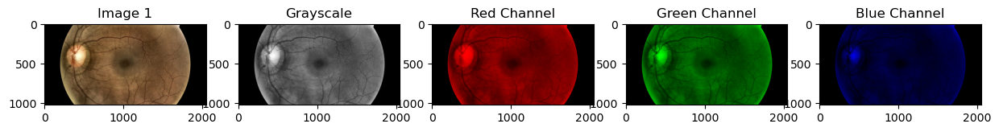

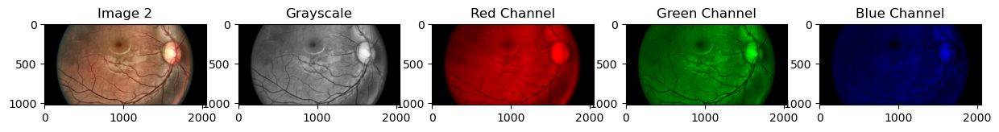

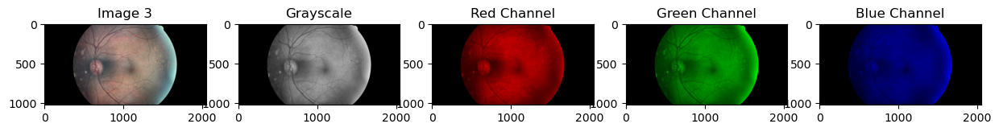

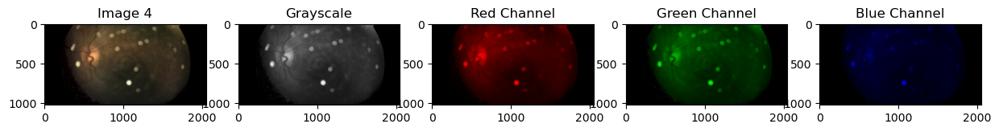

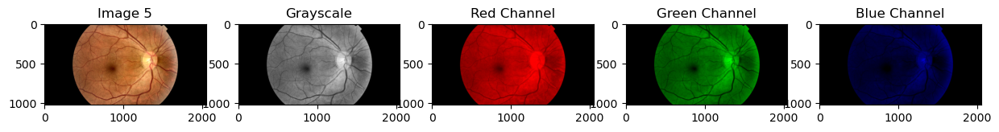

...

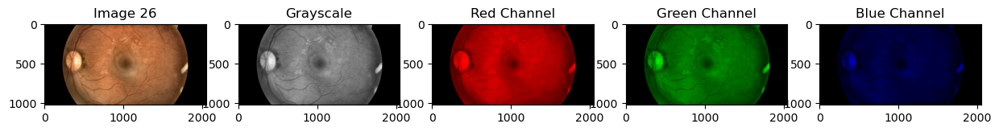

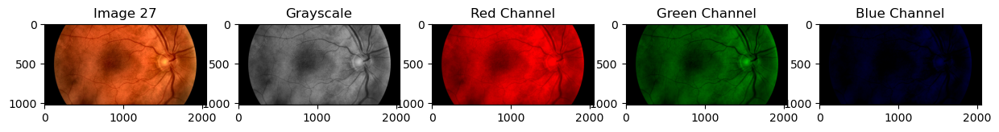

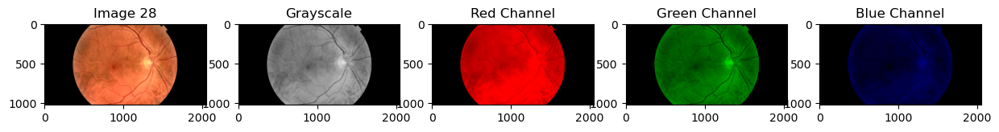

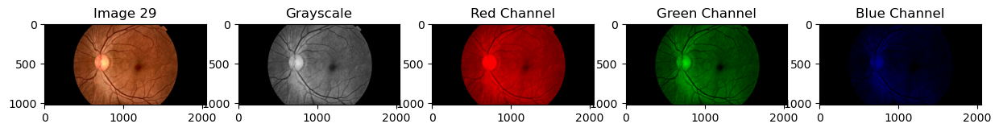

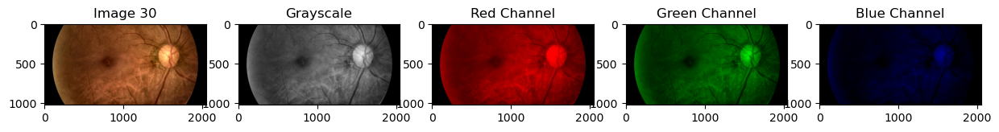

In [92]:
# See RGB channels and grayscale image to see what might assist in segmentations of optic cup and optic disk 

# Convert the images to grayscale and visualize each channel
for idx, cropped_image in enumerate(images):
    gray_image = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2GRAY)
    gray_image = cv2.cvtColor(gray_image, cv2.COLOR_GRAY2BGR)
    
    # Split the image into its RGB channels
    blue_channel, green_channel, red_channel = cv2.split(cropped_image)

    # Create zeros arrays for other channels
    zeros = np.zeros_like(red_channel)

    # Create images with only one color channel
    red_image = cv2.merge([zeros, zeros, red_channel])
    green_image = cv2.merge([zeros, green_channel, zeros])
    blue_image = cv2.merge([blue_channel, zeros, zeros])

    # Visualize each image with individual color channels
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 5, 1)
    plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {idx+1}")

    plt.subplot(1, 5, 2)
    plt.imshow(gray_image)
    plt.title("Grayscale")

    plt.subplot(1, 5, 3)
    plt.imshow(cv2.cvtColor(red_image, cv2.COLOR_BGR2RGB))
    plt.title("Red Channel")

    plt.subplot(1, 5, 4)
    plt.imshow(cv2.cvtColor(green_image, cv2.COLOR_BGR2RGB))
    plt.title("Green Channel")

    plt.subplot(1, 5, 5)
    plt.imshow(cv2.cvtColor(blue_image, cv2.COLOR_BGR2RGB))
    plt.title("Blue Channel")

    plt.show()


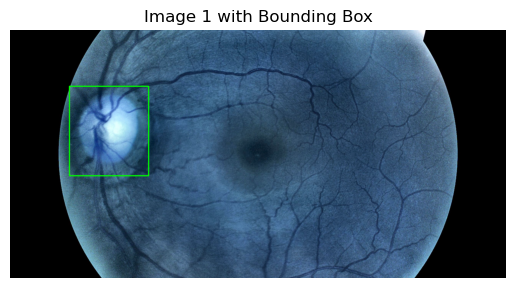

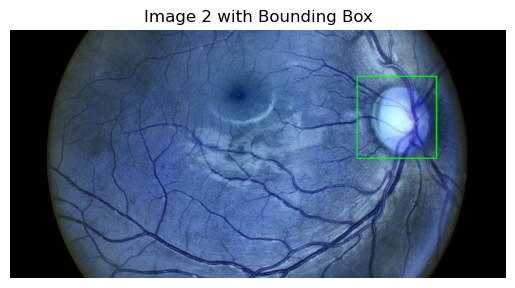

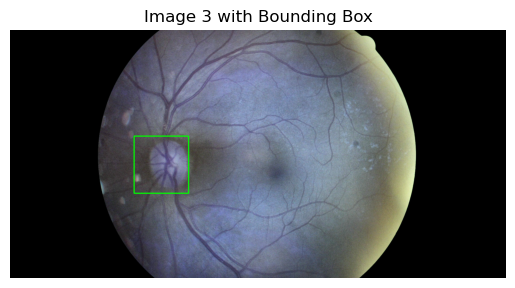

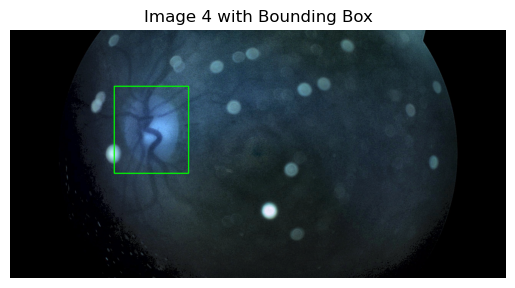

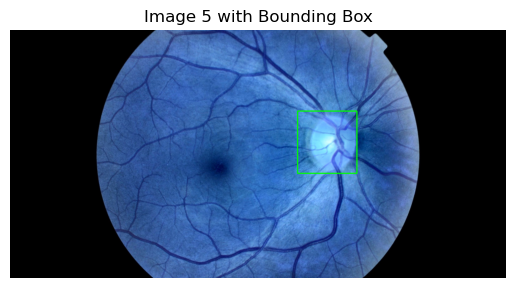

...

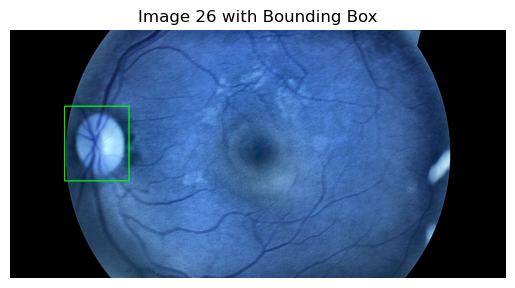

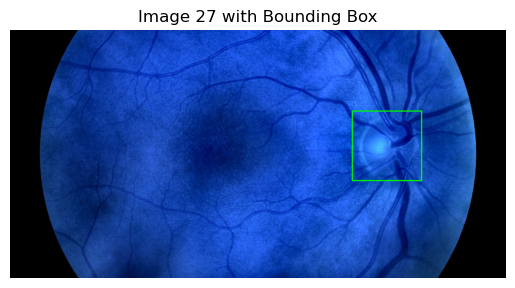

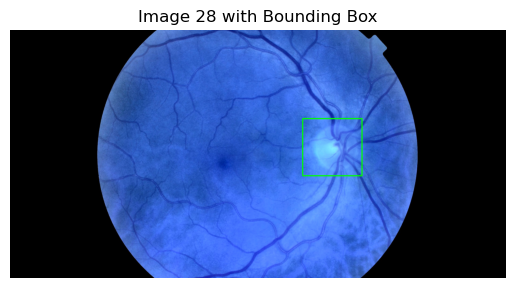

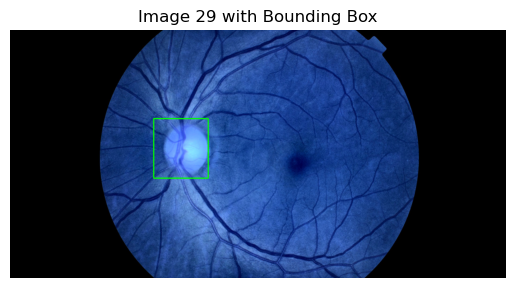

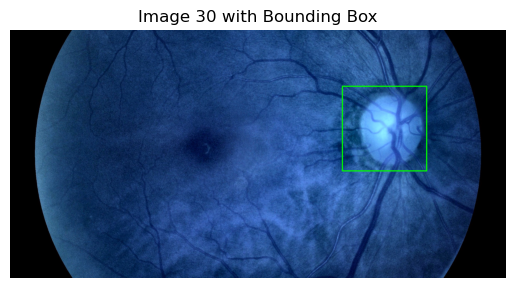

In [93]:
# Function to draw bounding boxes on images
def draw_bounding_box(image, bbox):
    x_adjusted, y_adjusted, width_adjusted, height_adjusted = bbox
    # Draw bounding box rectangle on image
    #cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.rectangle(image, (x_adjusted, y_adjusted), (x_adjusted + width_adjusted, y_adjusted + height_adjusted), (0, 255, 0), 4)
    return image

# Visualize images with bounding boxes
for i in range(len(labels)):
    image = images[i].copy()  # Make a copy of the image to avoid modifying the original
    bbox = labels[i]  # Get the bounding box for the current image
    # Draw bounding box on image
    image_with_bbox = draw_bounding_box(image, bbox)
    # Display image with bounding box
    plt.imshow(image_with_bbox)
    plt.title(f"Image {i+1} with Bounding Box")
    plt.axis('off')
    plt.show()

    
    
## Matt: FYI these images are showing as blueish instead of redish since you have to display it as BRG instead of RGB.
## Look at some of my other code if you're interested in seeing how you display it correctly
## Leaving it as blue has no impact on the later steps, it's just a matter of how it displays


##use half the width to make a radius and make a circular mask

In [94]:
def create_binary_mask(image_shape, bbox):
    mask = np.zeros(image_shape, dtype=np.uint8)
    x, y, width, height = bbox
    mask[y:y+height, x:x+width] = 1
    return mask

def convert_bboxes_to_masks(images, bboxes):
    masks = []
    for image, bbox in zip(images, bboxes):
        mask = create_binary_mask(image.shape[:2], bbox)
        masks.append(mask)
    return masks

# Example usage:
# Assuming X_train contains input images and y_train contains bounding box labels
masks_train = convert_bboxes_to_masks(X_train, y_train)
masks_val = convert_bboxes_to_masks(X_val, y_val)

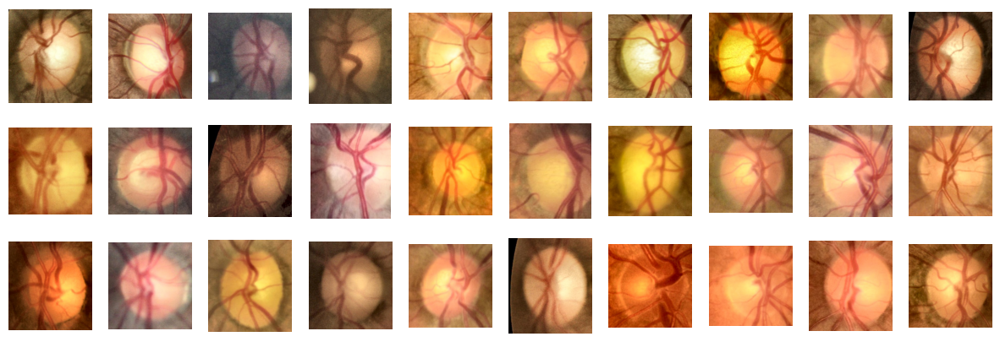

In [95]:
#Crop out bounding box 
#will get moved to after network for automated bounding box but for now trying something

# Function to crop images based on bounding box coordinates
def crop_outside_bounding_box(images, bounding_boxes):
    cropped_images = []
    for image, bbox in zip(images, bounding_boxes):
        x, y, width, height = bbox
        # Crop the bounding box region
        roi = image[y:y+height, x:x+width]
        # Create a mask for the bounding box region
        mask = np.zeros_like(roi)
        mask[:, :] = 255
        # Remove the black background
        masked_image = cv2.bitwise_and(roi, mask)
        cropped_images.append(masked_image)
    return cropped_images

# Crop the images
cropped_images = crop_outside_bounding_box(images, bounding_box_labels)

# Visualize the cropped images
plt.figure(figsize=(15, 5))
for i, cropped_image in enumerate(cropped_images):
    plt.subplot(3, 10, i+1)
    plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
plt.show()


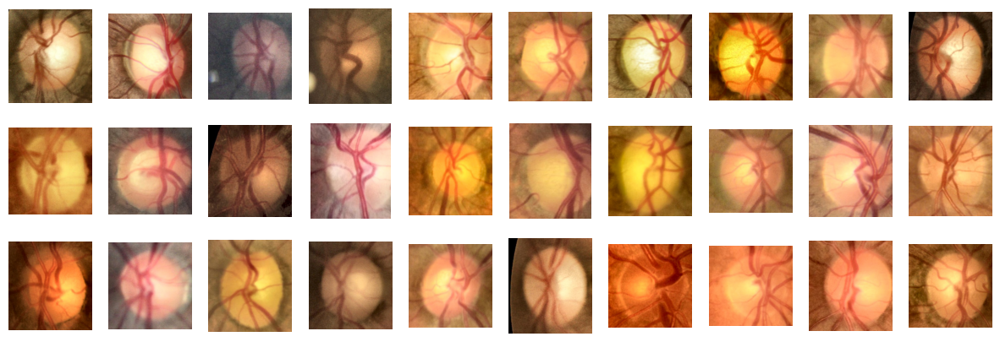

In [96]:
# Function to crop images based on bounding box coordinates
def crop_outside_bounding_box(images, bounding_boxes):
    cropped_images = []
    masks = []
    for image, bbox in zip(images, bounding_boxes):
        x, y, width, height = bbox
        # Crop the bounding box region
        roi = image[y:y+height, x:x+width]
        cropped_images.append(roi)
        # Create a mask for the bounding box region
        mask = np.zeros_like(roi)
        mask[:, :] = 255
        masks.append(mask)
    return cropped_images, masks

# Crop the images
cropped_images, masks = crop_outside_bounding_box(images, bounding_box_labels)

# Visualize the cropped images
plt.figure(figsize=(15, 5))
for i, (cropped_image, mask) in enumerate(zip(cropped_images, masks)):
    masked_image = cv2.bitwise_and(cropped_image, mask)
    plt.subplot(3, 10, i+1)
    plt.imshow(cv2.cvtColor(masked_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
plt.show()


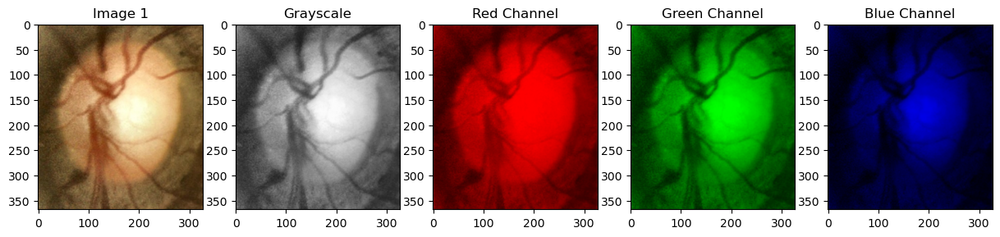

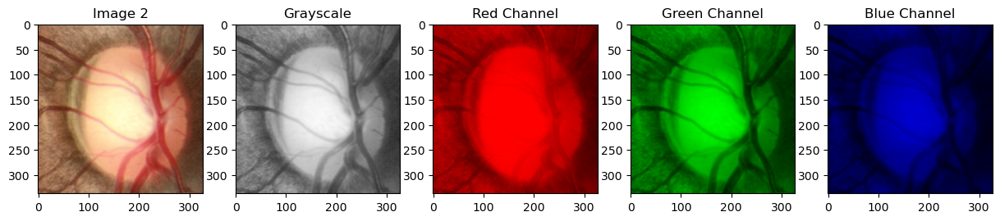

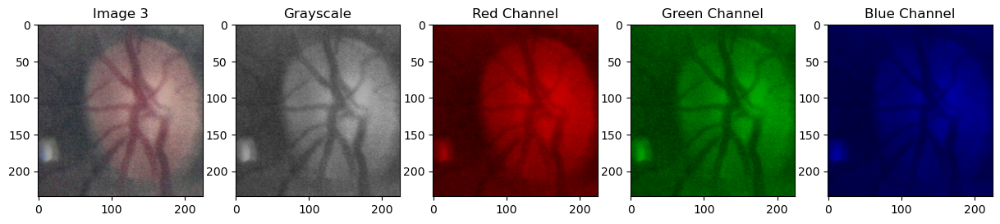

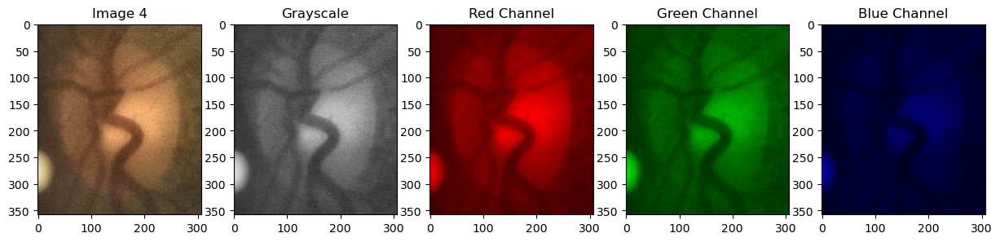

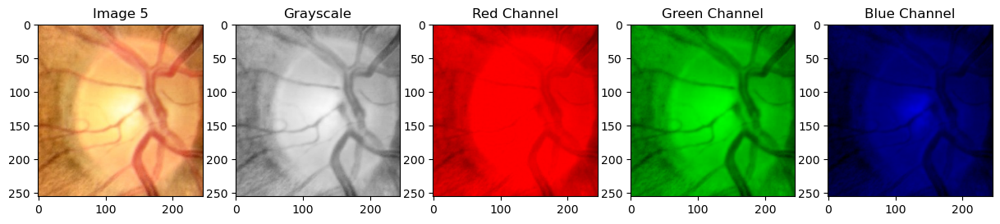

...

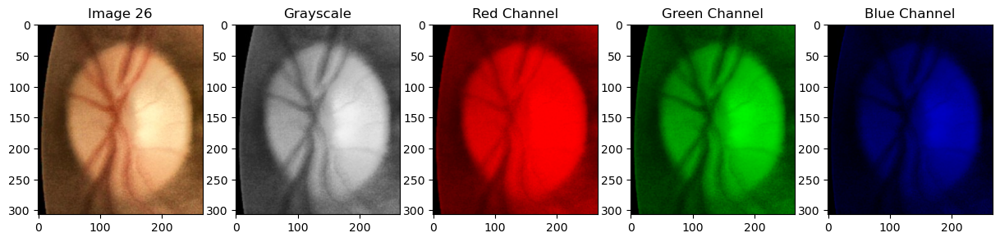

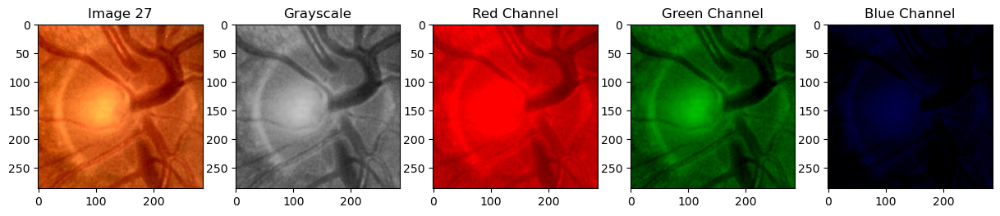

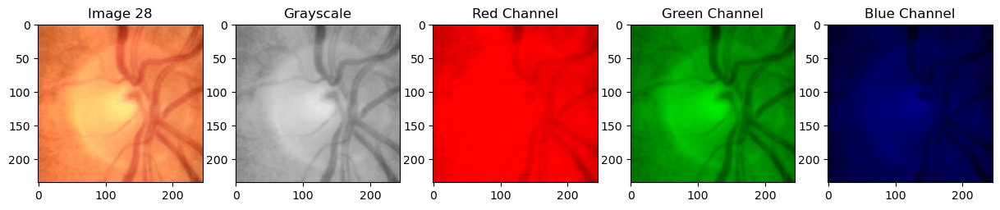

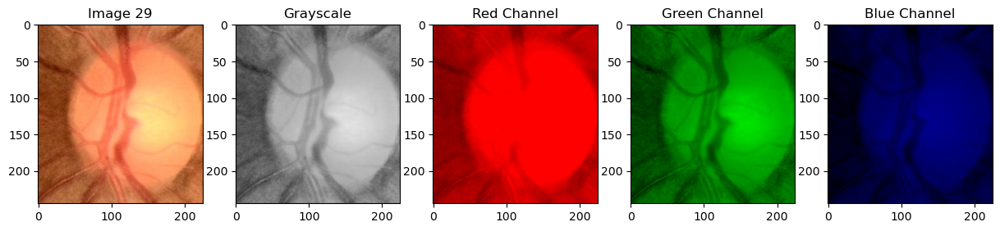

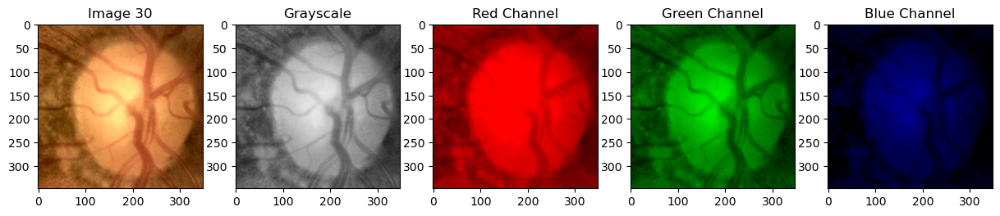

In [97]:
# Convert the images to grayscale and visualize each channel
for idx, cropped_image in enumerate(cropped_images):
    gray_image = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2GRAY)
    gray_image = cv2.cvtColor(gray_image, cv2.COLOR_GRAY2BGR)
    
    # Split the image into its RGB channels
    blue_channel, green_channel, red_channel = cv2.split(cropped_image)

    # Create zeros arrays for other channels
    zeros = np.zeros_like(red_channel)

    # Create images with only one color channel
    red_image = cv2.merge([zeros, zeros, red_channel])
    green_image = cv2.merge([zeros, green_channel, zeros])
    blue_image = cv2.merge([blue_channel, zeros, zeros])

    # Visualize each image with individual color channels
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 5, 1)
    plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {idx+1}")

    plt.subplot(1, 5, 2)
    plt.imshow(gray_image)
    plt.title("Grayscale")

    plt.subplot(1, 5, 3)
    plt.imshow(cv2.cvtColor(red_image, cv2.COLOR_BGR2RGB))
    plt.title("Red Channel")

    plt.subplot(1, 5, 4)
    plt.imshow(cv2.cvtColor(green_image, cv2.COLOR_BGR2RGB))
    plt.title("Green Channel")

    plt.subplot(1, 5, 5)
    plt.imshow(cv2.cvtColor(blue_image, cv2.COLOR_BGR2RGB))
    plt.title("Blue Channel")

    plt.show()

In [ ]:
#Automatic Detection of Bounding Boxes based on Bounding Box input images 

#Pre-trained network
model = torchvision.models.detection.ssd300_vgg16(pretrained = True)
model.eval()

classnames = []
with open('Glaucoma_Balanced_Dataset/Preprocessed_images_input_to_bound/bounding_box_labels_adjusted','r') as f:
    classnames = f.read().splitlines()

def load_image(image_path):
    image = cv2.imread(image_path)
    return image
 
def transform_image(image):
    img_transform = T.ToTensor()
    image_tensor = img_transform(image)
    return image_tensor

def detect_objects(model, image_tensor, confidence_threshold=0.80):
    with torch.no_grad():
        y_pred = model([image_tensor])
 
    bbox, scores, labels = y_pred[0]['boxes'], y_pred[0]['scores'], y_pred[0]['labels']
    indices = torch.nonzero(scores > confidence_threshold).squeeze(1)
 
    filtered_bbox = bbox[indices]
    filtered_scores = scores[indices]
    filtered_labels = labels[indices]
 
    return filtered_bbox, filtered_scores, filtered_labels

def draw_boxes_and_labels(image, bbox, labels, class_names):
    img_copy = image.copy()
 
    for i in range(len(bbox)):
        x, y, w, h = bbox[i].numpy().astype('int')
        cv2.rectangle(img_copy, (x, y), (w, h), (0, 0, 255), 5)
 
        class_index = labels[i].numpy().astype('int')
        class_detected = class_names[class_index - 1]
 
        cv2.putText(img_copy, class_detected, (x, y + 100), cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 0), 2, cv2.LINE_AA)
 
    return img_copy

from google.colab.patches import cv2_imshow
#image_path = '/content/mandog.jpg'
#img = load_image(image_path)
# Transform image
img_tensor = transform_image(image)
# Detect objects
bbox, scores, labels = detect_objects(model, img_tensor)
# Draw bounding boxes and labels
result_img = draw_boxes_and_labels(image, bbox, labels, classnames)
# Display the result
cv2_imshow(result_img)

In [ ]:
#Segmentation of Optic Disk 

def gnet_disk(input_shape, num_classes):
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    up6 = UpSampling2D(size=(2, 2))(conv5)
    
    merge6 = concatenate([conv4, up6], axis=3)
    conv6 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    up7 = UpSampling2D(size=(2, 2))(conv6)
    
    merge7 = concatenate([conv3, up7], axis=3)
    conv7 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    up8 = UpSampling2D(size=(2, 2))(conv7)
   
    merge8 = concatenate([conv2, up8], axis=3)
    conv8 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    up9 = UpSampling2D(size=(2, 2))(conv8)
    
    merge9 = concatenate([conv1, up9], axis=3)
    conv9 = Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(32, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = tf.keras.Model(inputs=inputs, outputs=conv10)

    return model

# Example usage
input_shape = (1024, 2048, 3)
num_classes = 1
model = gnet_disk(input_shape, num_classes)
model.summary()

In [ ]:
#Segmentation of Optic Cup 
def gnet_cup(input_shape, num_classes):
    inputs = Input(input_shape)

    # Encoder
    conv1 = Conv2D(34,(4,2), activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(34,(4,2), activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    
    pool1 = MaxPooling2D(pool_size=(4, 4))(conv1)
    conv2 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    
    pool2 = MaxPooling2D(pool_size=(4, 4))(conv2)
    conv3 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    
    pool3 = MaxPooling2D(pool_size=(4, 4))(conv3)
    conv4 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    
    pool4 = MaxPooling2D(pool_size=(4, 4))(conv4)
    conv5 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    up6 = UpSampling2D(size=(4, 4))(conv5)
    
    merge6 = concatenate([conv4, up6], axis=3)
    conv6 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    up7 = UpSampling2D(size=(4, 4))(conv6)
    
    merge7 = concatenate([conv3, up7], axis=3)
    conv7 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    up8 = UpSampling2D(size=(4, 4))(conv7)
   
    merge8 = concatenate([conv2, up8], axis=3)
    conv8 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(64, 4, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    up9 = UpSampling2D(size=(4, 4))(conv8)
    
    merge9 = concatenate([conv1, up9], axis=3)
    conv9 = Conv2D(34, (4,2), activation='relu', padding='same', kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(34, (4,2), activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = tf.keras.Model(inputs=inputs, outputs=conv10)

    return model

# Example usage
input_shape = (1024, 2048, 3)
num_classes = 1
model = gnet_cup(input_shape, num_classes)
model.summary()
